
# Electric field around self similar fractals

### A computational essay by Viktor Hochmann

## Introduction: What is a fractal?

A fractal is a complex pattern that is self-similar across different scales. They can be created by iterating a simple process multiple times. Fractal patterns are familiar to us, since nature is full of fractals. For instance: trees, rivers, coastlines, mountains, clouds, seashells, hurricanes, etc. The following figure shows the so-called Koch snowflake, which is one of the earliest fractals to have been described.

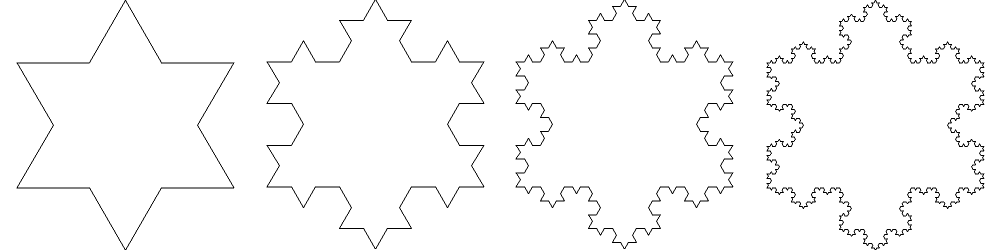

Figure 1: First four iterations ot the koch snowflake from ([yourmath wordpress](https://yourmaths.wordpress.com/2014/07/02/two-algorithms-for-generating-von-koch-snowflakes/))

In this notebook, we will try to simulate the electric field produced by a charge evenly distributed over this fractal and see whether there are any potential applications of this charge distribution. We will also try to understand how the resulting electric field changes for higher and higher iterations of the curve. Finally, we will try to find out whether the electric field resembles self similarities across self similar regions of the curve.
But before we do that, it is important to understand the method of constructing this fractal.

 One of three sides of the Koch snowflake of n-th order can be constructed in several stages. One side of the first stage is a shown in the following figure. The triangle in the middle of the curve is equilateral.

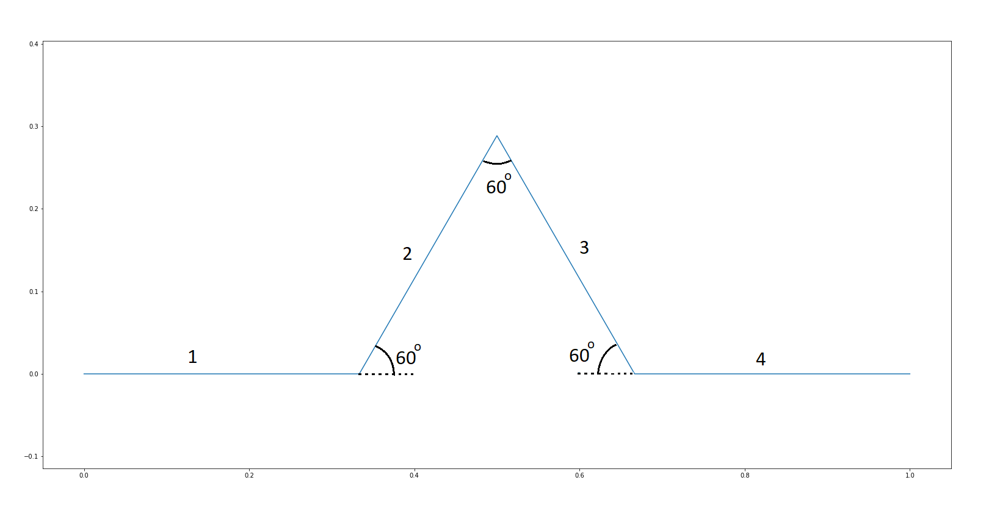

Figure 2: First stage of the Koch curve

Each succesive stage is then constructed by replacing the four sub-curves (labeled from 1 to 4) in the previous stage with the curve itself. Thus the second stage becomes

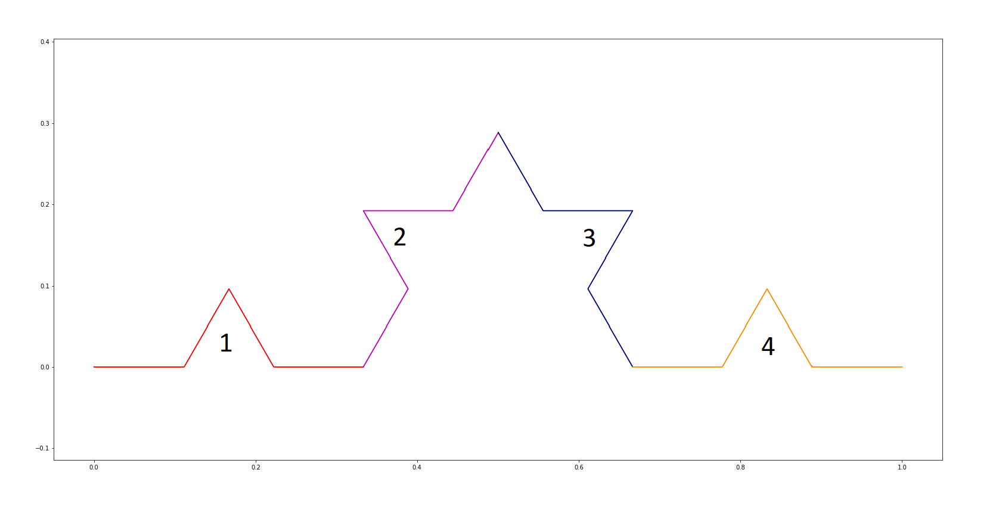

Figure 3: Second stage Koch curve

Note that each of the four curves with distinct color is the curve constructed in stage 1. Simirarly, to find the third stage, we replace the labeled curves with the curve constructed in second stage. 

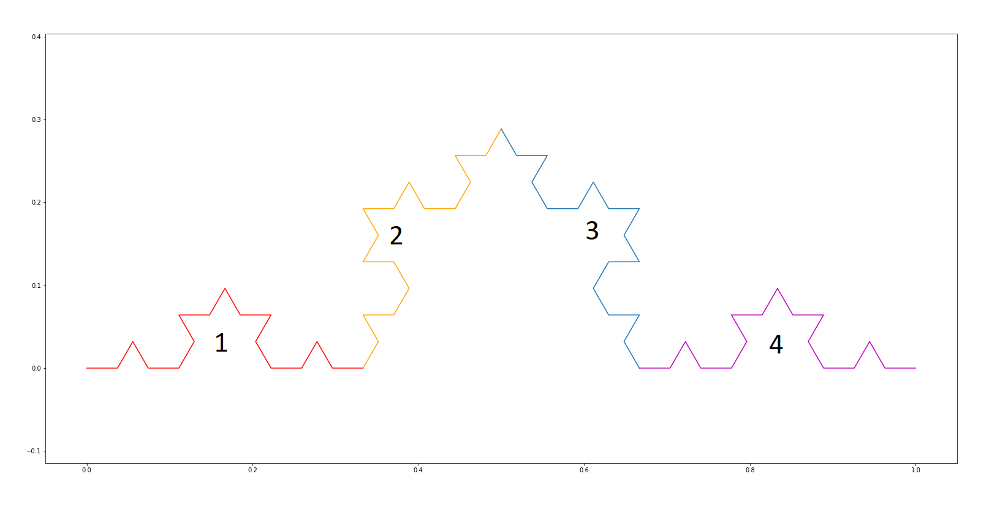

Figure 4: Third stage Koch curve

 To find the n-th iteration, we repeat this process n times. We will also make use of the fact that number of sides in the n-th order Koch curve equals 4^n. In order to construct the complete snowflake, we connect three such curves like three sides of an equilateral triangle. The number of sides in the complete snowflake is therefore 3*4^n.

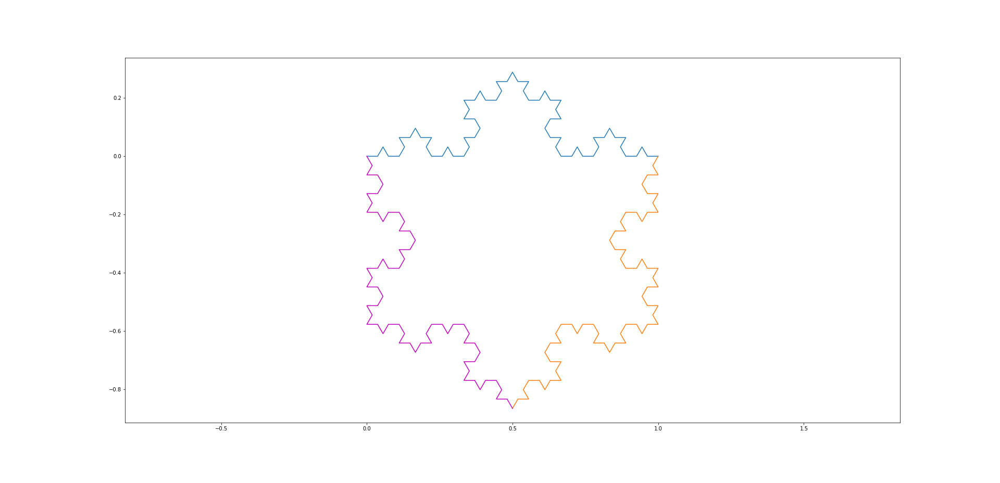

Figure 5: Third stage Koch snowflake.

To find the electric field, we will use the fact that each iteration of the fractal is a combination of straigth lines. This means that we can calculate the field produced by each line segment in the fractal, and use the superposition principle to find the total electric field of the system. In order to find the contribution from one line, we can devide it into many segments that we can treat as point charges. If the number of segments is large enough, the resulting electric field will effectively become the same as that of a continuous line of charge. 

# Functions


In this section, we will program two functions. The first one will construct the Koch curve of n-the order 
and make an array of points containing the position-coordinates of each line in the curve. The second function will take
two points as input and return the electric field produced by a line of charge stretching between the two points. We start
by importing the necessary packages.

In [13]:
import numpy as np
import matplotlib.pyplot as plt

We are now ready to program our first function. To do this, we will follow the construction steps described in the previous section. The function will contruct the curve iteratively, starting with a straight line and connecting its duplicates to itself as shown in figure 3. It will then repeat the process several times. To rotate the curves, we will multiply the curve by the [rotation matrix](https://en.wikipedia.org/wiki/Rotation_matrix).  

In [14]:
def kochcurve(N):
    """
    Return the coordinates of the line segments in the Koch curve of N-th order.
    N --> number of iterations
    """
    def rotationmatrix(theta):
            """
            return a matrix that rotates a set of vectors by theta radians
            """
            rotation_matrix = np.zeros((2,2))
            rotation_matrix[0,0] = np.cos(theta)
            rotation_matrix[0,1] = -np.sin(theta)
            rotation_matrix[1,0] = np.sin(theta)
            rotation_matrix[1,1] = np.cos(theta)
            
            return rotation_matrix
        
    form = np.array([0,0,1,0]).reshape(2,2)  # 0-th stage --> a straight line stretching between the points (0,0) and (0,1)
    
    # form is an array where first index is the point and second is dimension
    # form[3,1] is therefore point 3, y coordinate
    # form[6,0] is point 6, x coordinate
    
    def iterate(form):                                                # iterate the Koch curve
        newform = form                                                # new curve
        form_60_1 = np.matmul(form,rotationmatrix(-np.pi/3))          # old curve rotated by 60 degrees        
        form_60_2 = np.matmul(form,rotationmatrix(np.pi/3))           # old curve rotated by -60 degrees 
        newform = np.append(newform,form_60_1+newform[-1,:],axis = 0) # connect the rotated curve (60 degrees) to the endpoint
                                                                      # of newform
        newform = np.append(newform,form_60_2+newform[-1,:],axis = 0) # connect the rotated curve (-60 degrees) to the endpoint
                                                                      # of newform
        newform = np.append(newform,form + newform[-1,:],axis = 0)    # connect last part of the curve to the endpoint of 
                                                                      # newform
        return newform/np.linalg.norm(newform[-1,:]) # normalize the length and return the curve


    for i in range(N):
        form = iterate(form)   # iterate N times
        
    return form

To test consistency of our function, we can make a plot of the curve for n = 3.

In [5]:
f = kochcurve(3) # third order 

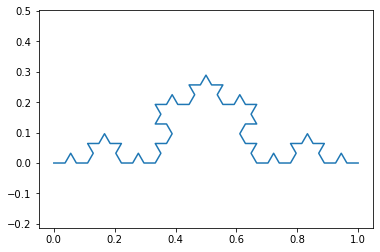

In [6]:
plt.plot(f[:,0],f[:,1])
plt.axis('equal')
plt.show()

This seems to be consistent with the Koch curve in the introduction section (figure 4).

The next step is to implement the second function. As mentioned before, this functon will calculate the electric field produced 
by a line of charge stretching between two points. We first devide this line into many smaller line segments, and calculate the contribution from each segment using the Coulomb's law, $$\vec{E} = k\frac{q}{r^2}\hat{r} $$ Where the charge q (charge of one line segment) equals the charge density times the length of a segment. We will use the numba library to make the calculations faster. Some of our simulations can take up to 20 minutes to run. We have therefore tried to optimize the code as much as we could.


In [15]:
from numba import jit

We start by making an grid of points where we calculate the electric field.

In [14]:
x = np.linspace(-0.5,1.5, 100)
y = np.linspace(-0.5,1.5,100)

xx,yy = np.meshgrid(x,y)

We are now ready to write the function.


In [16]:
@jit
def find_Efield(p1,p2,N,xx,yy):
    """
    Calculate electric field produced by a line of charge with uniform charge density
    stretching between two points (p1 and p2)
    p1,p2 --> endpoints 
    N     --> number of segments
    xx    --> x- coordinate grid
    yy    --> y- coordinate grid
    """
    Ex,Ey = np.meshgrid(x,y)         # electric field arrays , (this line might produce numba related warnings in Jupyter
                                     #                          but the code seems to work fine in spyder)
    Ex = Ex*0                        # make Ex and Ey zero
    Ey = Ey*0
    
    k = 9*10**9                      # Coulombs constant
    dxs = np.linspace(p1[0],p2[0],N) # x coordinate of segments
    dys = np.linspace(p1[1],p2[1],N) # y coordinates of segments
    dl = np.linalg.norm(p2-p1)/N     # length of a segment
    rho = 1.0e-09                    # charge density 
    dq = rho*dl                      # charge per segment = charge density x segment length
    
    for dx,dy in zip(dxs,dys):       # for dx,dy in all segment x and y coordinates:
       for i in range(len(Ex.flat)): 
              R = np.array([dx,dy])  # segment position
              r = np.array([xx.flat[i],yy.flat[i]]) # position of a point in our grid   
              dist = np.linalg.norm(r-R)            # distance between R and r
              
              if dist < 0.005:   # if segment is too close to our grid points
                 continue        # do nothing ( to avoid zeroDivisionError)
                 
              else:              # else calculate the field using Coulombs law 
                 Ex.flat[i],Ey.flat[i] = np.array([Ex.flat[i],Ey.flat[i]]) + k*dq/(dist**3)*(r-R)
                                 
    return Ex,Ey 

To test the function, we plot the electric field of a line of charge with endpoints (0, 0) an (1, 1).

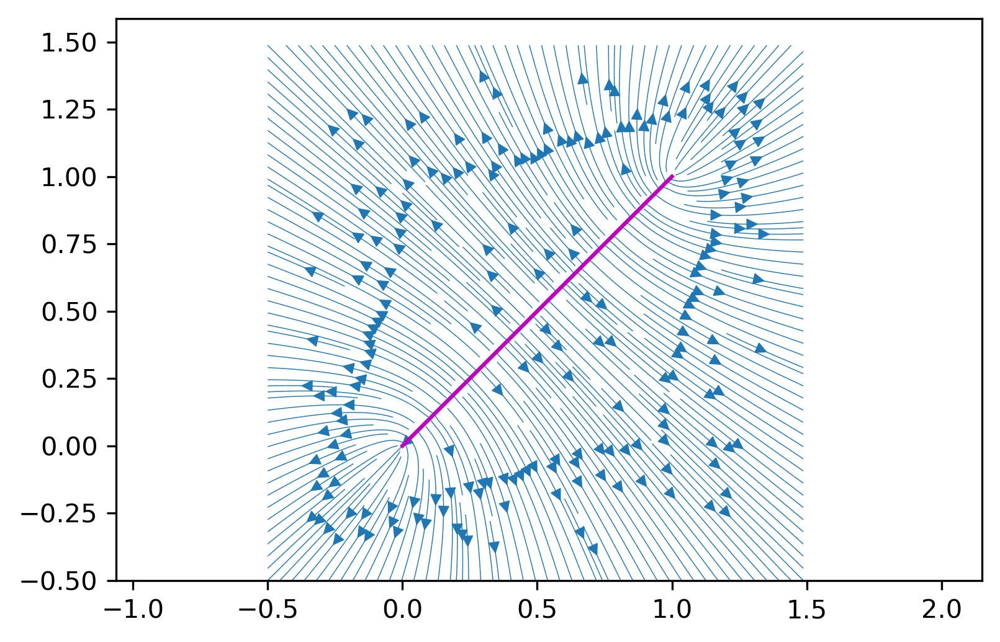

In [18]:
p1 = np.array([0,0]) # point 1
p2 = np.array([1,1]) # point 2
E_x,E_y = find_Efield(p1, p2,100 ,xx,yy)

plt.figure(dpi=300)
plt.streamplot(xx,yy,E_x,E_y,density = 3, linewidth = 0.35)  # field lines
plt.plot([p1[0],p2[0]],[p1[1],p2[1]],'m-')                   # line of charge
plt.axis('equal')
plt.show()

The field seems to have mirror symmetri about the charged line segment (magenta). This is exactly what we would expect from this charge distribution, indicating that our implementation of the function was successful.

## Simulating electric field

The next step is to use the E_field function to calculate contribution from each line segment in the
fractal, and find the sum of all contributions. We can then plot the streamlines of the field as well as the curves where the magnitude of the field is constant. The execution time of these simulations increases rapidly with increasing fractal stage, where the simulation of the field for n = 5 takes around 20 minutes to run. The code for each simulation will be almost the same. The only important difference will be the stage of the fractal (N) and the number of line segment divisions (specified in function call).

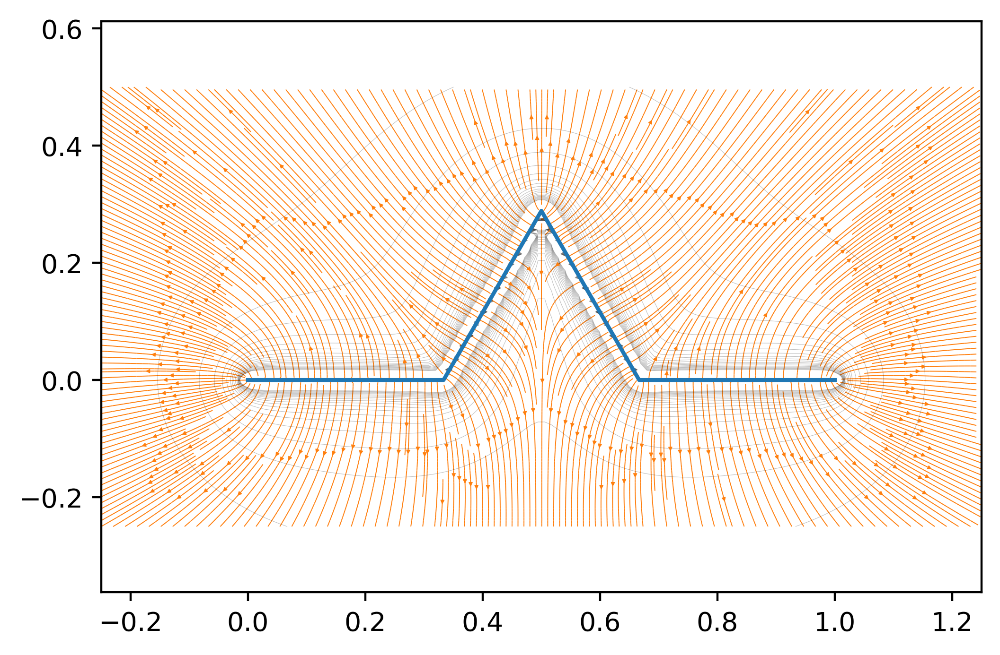

In [8]:
x = np.linspace(-0.25,1.25, 130) 
y = np.linspace(-0.25,0.5,130)  
xx,yy = np.meshgrid(x,y)

Exx = 0   # total x component of electric field (sum of all contributions)
Eyy = 0   # total y component of electric field (sum of all contributions)
N = 1     # fractal stage
lines = kochcurve(N)
for i in range(4**N):                               # number of sides in Koch curve is 4^N where N is the number of iterations
    Ex,Ey = find_Efield(lines[2*i],lines[2*i+1],100,xx,yy) # calculate E-field from one line segment 
    Exx += Ex                                             # add contribution
    Eyy += Ey                                             # add contribution

plt.figure(dpi = 400)
plt.plot(lines[:,0],lines[:,1])                                                                       # plot Koch curve
plt.streamplot(xx,yy,Exx,Eyy,density= 5, linewidth = 0.35,arrowsize = 0.3)                            # plot field lines
plt.contour(xx,yy,np.sqrt(Exx**2+Eyy**2),np.linspace(5,1000,20),linewidths=0.2,alpha=0.25,colors='k') # plot field magnitude
plt.axis('equal')
plt.show()

The first thing notice is that the electric field is perpendicular to the curve. We knew this was true for conductors, but this simulation indicates it is true for any linear charge distribution. We could prove this by using the same argument that works for conductors (see [Kompendium](https://www.uio.no/studier/emner/matnat/fys/FYS1120/h19/pensumliste/elektromagnetisme.pdf) page 43). The level curves (gray) represent the points where the electric field has constant magnitude.
If we look carefully at the plot, we see that the level curves are densely arranged near the sharp regions of the curve. This means that the electric field in these regions decreases somewhat faster with increasing distance. We can explain this by realizing that the field right under the curve can be approximated as a line of charge, for which the electric field decreases relatively slowly ($E \sim \frac{1}{r}$).
We can now run the same code for the second stage of the Koch curve.

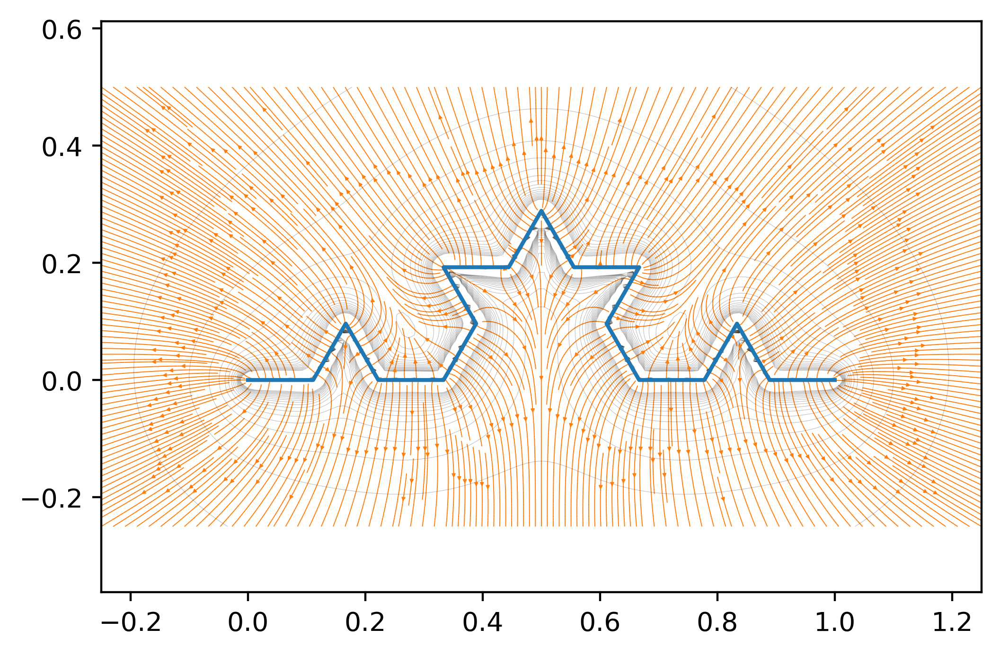

In [22]:
x = np.linspace(-0.25,1.25, 150)
y = np.linspace(-0.25,0.5,150)
xx,yy = np.meshgrid(x,y)

Exx = 0   # total x component of electric field (sum of all contributions)
Eyy = 0   # total y component of electric field (sum of all contributions)
N = 2     # second stage
lines = kochcurve(N)
for i in range(4**N):                               # number of sides in Koch curve is 4^N where N is the number of iterations
    Ex,Ey = find_Efield(lines[2*i],lines[2*i+1],30,xx,yy) # calculate E-field from one line segment 
    Exx += Ex                                             # add contribution
    Eyy += Ey                                             # add contribution

plt.figure(dpi = 400)
plt.plot(lines[:,0],lines[:,1])                                                                               # plot Koch curve
plt.streamplot(xx,yy,Exx,Eyy,density= 5, linewidth = 0.35,arrowsize = 0.3)                                    # plot field lines
plt.contour(xx,yy,np.sqrt(Exx**2 + Eyy**2),np.linspace(5,1000,20),linewidths = 0.2,alpha = 0.25,colors = 'k') # plot potential
plt.axis('equal')
plt.show()

   There are some changes in the field on the global scale. There are also some new regions where the field seems to be almost uniform. The next step is to simulate the field for n = 3. Note that we are gradually decreasing the number of segment divisions in the E_field function, to make the simulation less computationally intensive. This doesn't make the simulation any less realistic, since the length of the lines decreases with n.

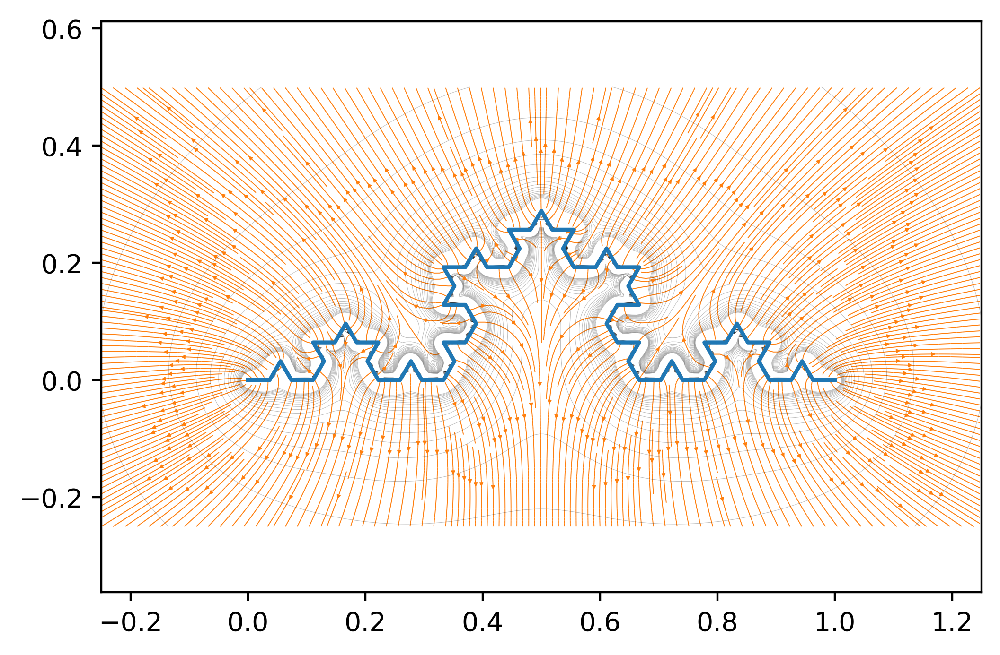

In [6]:
x = np.linspace(-0.25,1.25, 200) 
y = np.linspace(-0.25,0.5,200)  
xx,yy = np.meshgrid(x,y)

Exx = 0   # total x component of electric field (sum of all contributions)
Eyy = 0   # total y component of electric field (sum of all contributions)
N = 3     # third stage
lines = kochcurve(N)
for i in range(4**N):                               # number of sides in Koch curve is 4^N where N is the number of iterations
    Ex,Ey = find_Efield(lines[2*i],lines[2*i+1],30,xx,yy) # calculate E-field from one line segment 
    Exx += Ex                                             # add contribution
    Eyy += Ey                                             # add contribution

plt.figure(dpi = 400)
plt.plot(lines[:,0],lines[:,1])                                                                              # plot Koch curve
plt.streamplot(xx,yy,Exx,Eyy,density= 5, linewidth = 0.35,arrowsize = 0.3)                                   # plot field lines
plt.contour(xx,yy,np.sqrt(Exx**2 + Eyy**2),np.linspace(5,1000,20),linewidths = 0.2,alpha = 0.25,colors = 'k') # plot potential
plt.axis('equal')
plt.show()

If we look carefully at the gray curves, we see that they are closer to the Koch curve in the inner side of any curvature. This indicates that the electric field in these regions is somewhat weaker than on the other side where the distance between the curves is larger. We now simulate the field for the 5-th order Koch curve. 

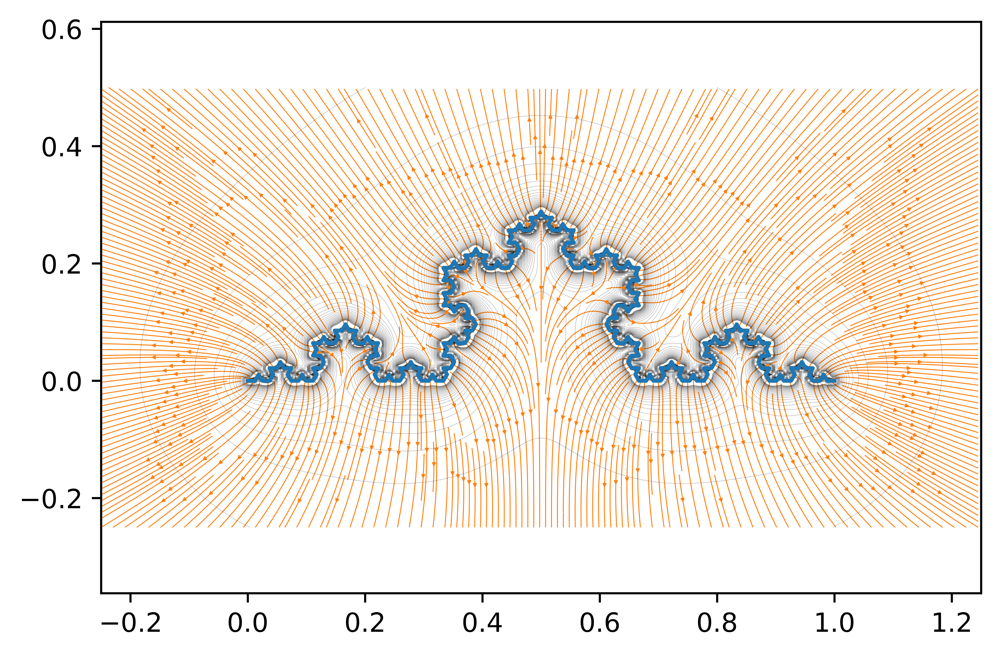

In [13]:
x = np.linspace(-0.25,1.25, 300) 
y = np.linspace(-0.25,0.5,300)  
xx,yy = np.meshgrid(x,y)

Exx = 0   # total x component of electric field (sum of all contributions)
Eyy = 0   # total y component of electric field (sum of all contributions)
N = 4
lines = kochcurve(N)
for i in range(4**N):                               # number of sides in Koch curve is 4^N where N is the number of iterations
    Ex,Ey = find_Efield(lines[2*i],lines[2*i+1],30,xx,yy) # calculate E-field from one line segment 
    Exx += Ex                                             # add contribution
    Eyy += Ey                                             # add contribution
                                                          # (useful to estimate execution time of the program)
plt.figure(dpi = 1000)
plt.plot(lines[:,0],lines[:,1])                                                                              # plot Koch curve
plt.streamplot(xx,yy,Exx,Eyy,density= 5, linewidth = 0.35,arrowsize = 0.3)                                   # plot field lines
plt.contour(xx,yy,np.sqrt(Exx**2 + Eyy**2),np.linspace(5,3000,30),linewidths = 0.2,alpha = 0.25,colors = 'k') # plot potential
plt.axis('equal')
plt.show()

Fourth stage Koch curve

There don't seem to be any significant changes in the electric field on the global scale. However the effect we found in the previous plot is even stronger. The white regions near the blue curve are always on the outer side of the curvature meaning the field in these regions is much stronger. This makes sence because here, the field contributions will add up while on the other side they will cancel each other out.
In the next simulation we will find the electric field produced by a full Koch snowflake (see fig.1). In order to do this, we need to redefine the function constructing the Koch curve. We will follow the steps explained in the introduction section. We need to connect three duplicates of the curve produced by the old function and connect them like the three sides of an equilateral triangle (fig.4).

In [12]:
def snowflake(N):
    """
    N --> number of iterations
    """
    def rotationmatrix(theta):
            """
            return a metrix that rotates a vector by theta radians
            """
            rotation_matrix = np.zeros((2,2))
            rotation_matrix[0,0] = np.cos(theta)
            rotation_matrix[0,1] = -np.sin(theta)
            rotation_matrix[1,0] = np.sin(theta)
            rotation_matrix[1,1] = np.cos(theta)
            
            return rotation_matrix
    form = np.array([0,0,1,0]).reshape(2,2)      # 0-th stage --> a straight line stretching
                                                 # between the points (0,0) and (0,1)
    
    # form is an array where first index is point and second is dimension
    # form[3,1] is therefore point 3 y coordinate
    # form[6,0] is point 6 x coordinate
    
    def iterate(form):                                                 # iterate the Koch curve
        newform = form                                                 # new curve
        form_60_1 = np.matmul(form,rotationmatrix(-np.pi/3))           # old curve rotated by 60 degrees        
        form_60_2 = np.matmul(form,rotationmatrix(np.pi/3))            # old curve rotated by -60 degrees        
        newform = np.append(newform,form_60_1 + newform[-1,:],axis = 0)# connect the rotated curve (60 degrees) to the endpoint
                                                                       # of newform
        newform = np.append(newform,form_60_2 + newform[-1,:],axis = 0)# connect the rotated curve (-60 degrees) to the endpoint
                                                                       # of newform
        newform = np.append(newform,form + newform[-1,:],axis = 0)     # connect last part of the curve to the endpoint of 
                                                                       # of newform
        
        return newform/np.linalg.norm(newform[-1,:])                   # normalize the curve


    for i in range(N):
        form = iterate(form)
    
    form_2side = np.matmul(form,rotationmatrix(2*np.pi/3))             # connect the other two sides of the "equilateral triangle"
    form_3side = np.matmul(form,rotationmatrix(4*np.pi/3))
    form = np.append(form,form_2side + form[-1,:],axis = 0)
    form = np.append(form,form_3side + form[-1,:],axis = 0)
    return form


 We can now simulate the complete fifth order Koch snowflake. This simulation can take up to 20 minutes to run.

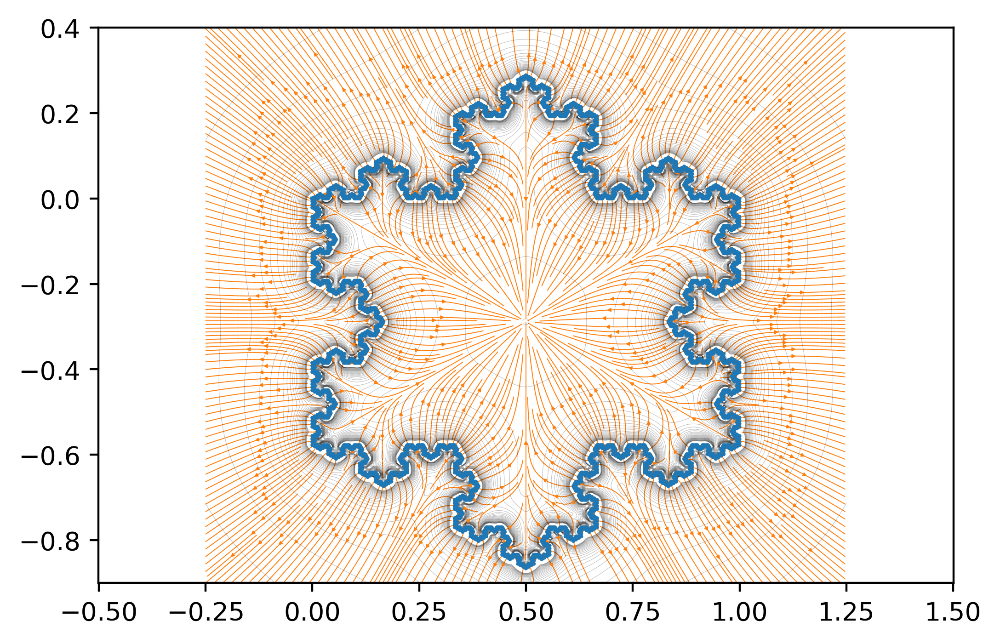

In [18]:
x = np.linspace(-0.25,1.25, 200) 
y = np.linspace(-0.9,0.4,200)  
xx,yy = np.meshgrid(x,y)

Exx = 0
Eyy = 0
N = 5          # 5-th order
lines = snowflake(N)
for i in range(3*4**N):                                   # number of sides in Koch curve is 3*4^N where N is the number of iterations
    Ex,Ey = find_Efield(lines[2*i],lines[2*i+1],5,xx,yy)  # calculate E-field from one line segment 
    Exx += Ex                                             # add contribution
    Eyy += Ey                                             # add contribution

plt.figure(dpi = 400)
plt.plot(lines[:,0],lines[:,1])                                                                              # plot Koch curve
plt.streamplot(xx,yy,Exx,Eyy,density= 5, linewidth = 0.35,arrowsize = 0.3)                                   # plot field lines
plt.contour(xx,yy,np.sqrt(Exx**2 + Eyy**2),np.linspace(5,3000,30),linewidths = 0.2,alpha = 0.25,colors = 'k') # plot potential
plt.axis('equal')
plt.show()


Fifth stage Koch snowflake

This time, we can see all of the features we saw earlier. An interesting feature that we didn't see before is that the electric field inside the snowflake always points towards the center. The field in the center of the snowflake must be zero for symmetri reasons. This means that if there was a positively charged particle inside the snowflake, it would have a stable equilibrium point in the middle. This could be potentially used in some sort of particle traps. In the last two simulations we will try to see whether the electric field produced by the 6-th order Koch curve preserves self similarity in regions where the curve is self similar. 

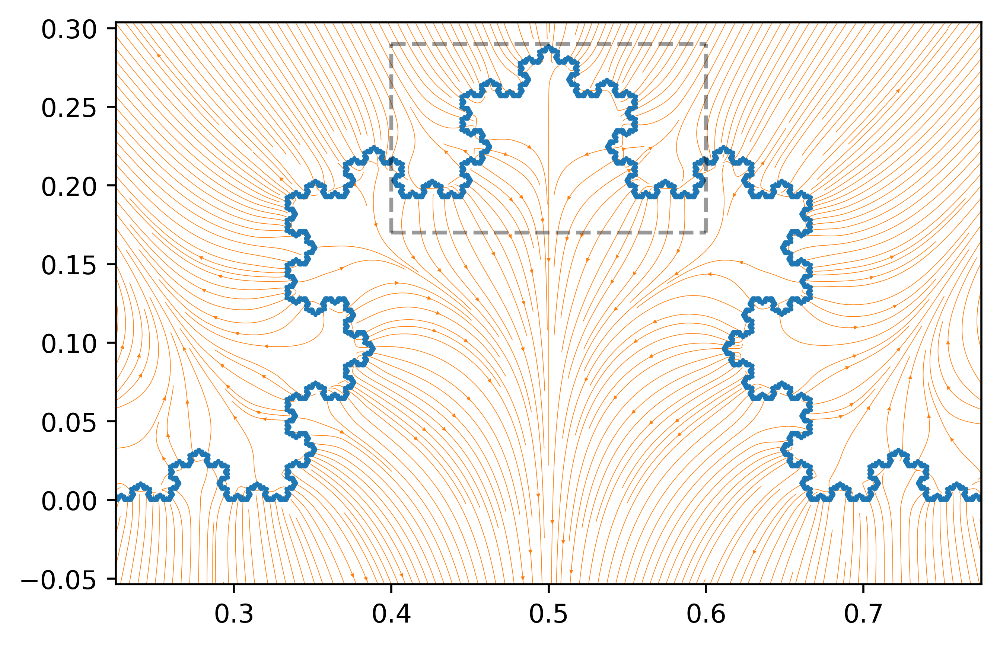

In [12]:
x = np.linspace(-0.25,1.25, 100) 
y = np.linspace(-0.25,0.5,100) 
xx,yy = np.meshgrid(x,y)

Exx = 0
Eyy = 0
N = 6                 # 6-th order
lines = kochcurve(N)
for i in range(4**N):
    Ex,Ey = find_Efield(lines[2*i],lines[2*i+1],5,xx,yy) # sum of all contributions
    Exx += Ex
    Eyy += Ey

plt.figure(dpi = 500)
plt.plot(lines[:,0],lines[:,1])
plt.streamplot(xx,yy,Exx,Eyy,density= 12, linewidth = 0.25,arrowsize = 0.3)
plt.axis('equal')
plt.axis([0.225,0.775,0.-0.05,0.3]) 

plt.plot([0.4,0.6],[0.17,0.17],'k--',alpha = 0.4)  # gray rectangle
plt.plot([0.4,0.6],[0.29,0.29],'k--',alpha = 0.4)
plt.plot([0.4,0.4],[0.17,0.29],'k--',alpha = 0.4)
plt.plot([0.6,0.6],[0.17,0.29],'k--',alpha = 0.4)

plt.show()

Let's now zoom in on the gray rectangle.

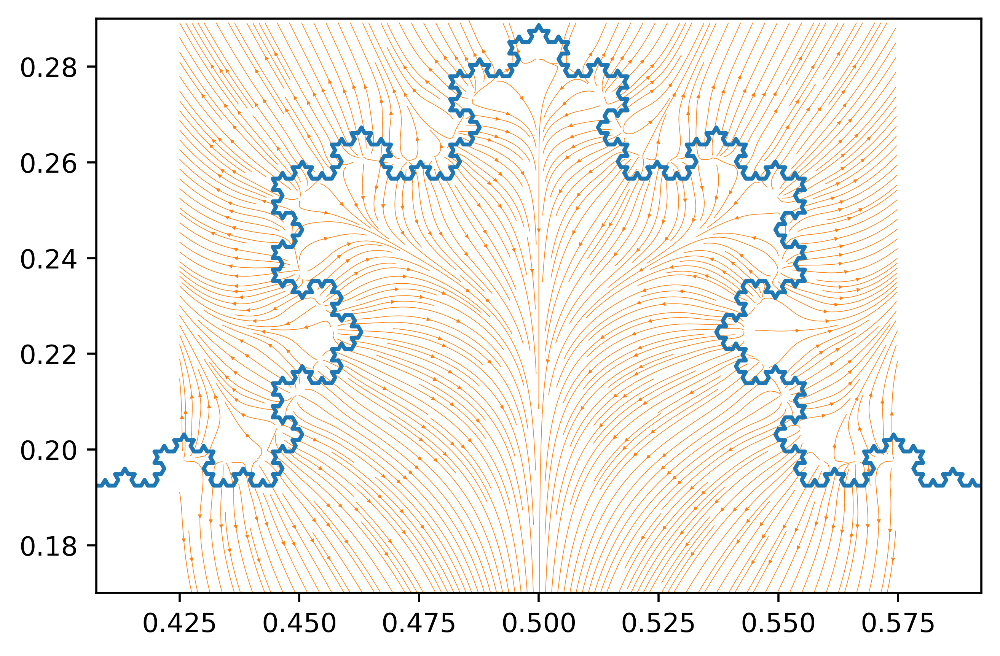

In [9]:
x = np.linspace(0.425,0.575, 100) 
y = np.linspace(0.17,0.29,100) 
xx,yy = np.meshgrid(x,y)

Exx = 0
Eyy = 0
N = 6                # 6-th order
lines = kochcurve(N)
for i in range(4**N): 
    Ex,Ey = find_Efield(lines[2*i],lines[2*i+1],5,xx,yy) # sum of all contributions
    Exx += Ex
    Eyy += Ey

plt.figure(dpi = 500)
plt.plot(lines[:,0],lines[:,1])
plt.streamplot(xx,yy,Exx,Eyy,density= 4, linewidth = 0.25,arrowsize = 0.3)
plt.axis('equal')
plt.axis([0.425,0.575,0.17,0.29]) 

plt.show()

The two electric fields seem to have many similarities. In fact, they are almost indistinguishable. This suggests that these field are indeed, self similar. However, it is possible that there are slight changes caused by the charges outside these regions. For this reason, a more quantitative approach would be needed to verify this hyposesis.

## Conclusion

There wasn't any immidiately evident application of these confugurations other than particle traps.
We didn't find any global changes in the field when we increased the number of iterations. However there were some interesting local variations in the field. These local field variations are heavily dependent of the on the curvature of the charge distribution.
Our simulation also showed that the electric field lines are perpendicular to the source, even when the field source is not an ideal conductor. 
Finally, we learned that the electric field seems to have self-similarities across self-similar regions of the curve, although further research is needed to verify the validity of this statement.